In [1]:
# Load data from huggingface
from datasets import load_dataset
dataset = load_dataset("maartengr/arxiv_nlp")["train"]
 
# Extract specific metadata
abstracts = dataset["Abstracts"]
years = dataset["Years"]
categories = dataset["Categories"]
titles = dataset["Titles"]

Generating train split: 0 examples [00:00, ? examples/s]

In [3]:
from sentence_transformers import SentenceTransformer
 
# We load our model
embedding_model = SentenceTransformer('all-MiniLM-L6-v2')
 
# The abstracts are converted to vector representations
embeddings = embedding_model.encode(abstracts)

In [9]:
!pip install umap-learn

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [13]:
import umap.umap_ as umap
 
# We instantiate our UMAP model
umap_model = umap.UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine')
 
# We fit and transform our embeddings to reduce them
reduced_embeddings = umap_model.fit_transform(embeddings)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [14]:
from hdbscan import HDBSCAN
 
# We instantiate our HDBSCAN model
hdbscan_model = HDBSCAN(min_cluster_size=15, metric='euclidean', cluster_selection_method='eom')
 
# We fit our model and extract the cluster labels
hdbscan_model.fit(reduced_embeddings)
labels = hdbscan_model.labels_

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

<Axes: xlabel='x', ylabel='y'>

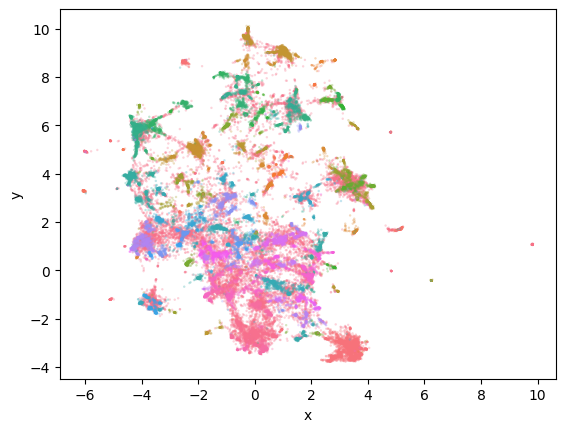

In [22]:
import seaborn as sns
import pandas as pd
import numpy as np
 
# Reduce 384-dimensional embeddings to 2 dimensions for easier visualization
reduced_embeddings = umap.UMAP(n_neighbors=15, n_components=2, 
min_dist=0.0, metric='cosine').fit_transform(embeddings)
df = pd.DataFrame(np.hstack([reduced_embeddings, labels.reshape(-1, 1)]),
     columns=["x", "y", "cluster"]).sort_values("cluster")
 
# Visualize clusters
df.cluster = df.cluster.astype(int).astype(str)
sns.scatterplot(data=df, x='x', y='y', hue='cluster', 
   linewidth=0, legend=False, s=3, alpha=0.3)

In [23]:
for index in np.where(labels==1)[0][:3]:
    print(abstracts[index])

  In this paper, a supervised learning technique for extracting keyphrases of
Arabic documents is presented. The extractor is supplied with linguistic
knowledge to enhance its efficiency instead of relying only on statistical
information such as term frequency and distance. During analysis, an annotated
Arabic corpus is used to extract the required lexical features of the document
words. The knowledge also includes syntactic rules based on part of speech tags
and allowed word sequences to extract the candidate keyphrases. In this work,
the abstract form of Arabic words is used instead of its stem form to represent
the candidate terms. The Abstract form hides most of the inflections found in
Arabic words. The paper introduces new features of keyphrases based on
linguistic knowledge, to capture titles and subtitles of a document. A simple
ANOVA test is used to evaluate the validity of selected features. Then, the
learning model is built using the LDA - Linear Discriminant Analysis - and


### Topic Modeling

#### BERTopic

In [2]:
from bertopic import BERTopic
from sklearn.datasets import fetch_20newsgroups

docs = fetch_20newsgroups(subset='all',  remove=('headers', 'footers', 'quotes'))['data']

topic_model = BERTopic()
topics, probs = topic_model.fit_transform(docs)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitl

In [4]:
len(topics)

18846

In [6]:
topics[:10]

[0, 4, 55, -1, 96, 172, -1, 0, 0, -1]

In [7]:
probs[:10]

array([1.        , 1.        , 0.34902908, 0.        , 0.54125155,
       1.        , 0.        , 1.        , 1.        , 0.        ])

In [8]:
# Load data from huggingface
from datasets import load_dataset
dataset = load_dataset("maartengr/arxiv_nlp")

# Extract specific metadata
abstracts = dataset["train"]["Abstracts"]
years = dataset["train"]["Years"]
categories = dataset["train"]["Categories"]
titles = dataset["train"]["Titles"]

In [9]:
# Train our topic model in only three lines of code
from bertopic import BERTopic
 
topic_model = BERTopic()
topics, probs = topic_model.fit_transform(abstracts)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

In [10]:
from umap import UMAP
from bertopic import BERTopic
 
# Using a custom UMAP model
umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
 
# Train our model
topic_model = BERTopic(umap_model=umap_model)
topics, probs = topic_model.fit_transform(abstracts)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

In [11]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,16978,-1_of_and_the_to,"[of, and, the, to, language, in, we, models, t...","[ Recently, Large Language Models (LLM) have ..."
1,0,2428,0_speech_asr_recognition_acoustic,"[speech, asr, recognition, acoustic, endtoend,...","[ All-neural, end-to-end ASR systems gained r..."
2,1,956,1_summarization_summaries_summary_abstractive,"[summarization, summaries, summary, abstractiv...",[ Pre-trained neural abstractive summarizatio...
3,2,650,2_gender_bias_biases_fairness,"[gender, bias, biases, fairness, debiasing, st...",[ With the growing deployment of large langua...
4,3,613,3_hate_offensive_speech_detection,"[hate, offensive, speech, detection, abusive, ...",[ With growing role of social media in shapin...
...,...,...,...,...,...
399,398,10,398_nerd_annotation_textscyedda_tanker,"[nerd, annotation, textscyedda, tanker, workbe...","[ In this paper, we introduce \textsc{Yedda},..."
400,399,10,399_flmr_visual_vqa_ravqa,"[flmr, visual, vqa, ravqa, images, multimodal,...",[ This work deals with the challenge of learn...
401,400,10,400_sense_senses_embeddings_word,"[sense, senses, embeddings, word, metasense, s...",[ Sense embedding learning methods learn diff...
402,401,10,401_phonology_phonological_reduplication_ufs,"[phonology, phonological, reduplication, ufs, ...",[ Coordinate compounds (CCs) and elaborate ex...


In [12]:
topic_model.get_topic(2)

[('gender', 0.028400445735339414),
 ('bias', 0.026751107222068284),
 ('biases', 0.018932407672206865),
 ('fairness', 0.009372977657178426),
 ('debiasing', 0.00915550574970211),
 ('stereotypes', 0.008385411234404819),
 ('social', 0.005674554016892917),
 ('biased', 0.005018296829500737),
 ('groups', 0.004974849490993971),
 ('demographic', 0.004564776178655513)]

In [13]:
topic_model.find_topics("topic modeling")

([13, 196, 37, 356, 212],
 [0.7681302, 0.48816752, 0.47957826, 0.47909284, 0.46817043])

In [14]:
topic_model.get_topic(17)

[('graph', 0.019999151054145594),
 ('kgc', 0.01665679256829651),
 ('kg', 0.015048235074562339),
 ('knowledge', 0.014754295739864146),
 ('kgs', 0.014748027030220451),
 ('completion', 0.014255394034949714),
 ('graphs', 0.013512346706340264),
 ('link', 0.013339045817227915),
 ('entities', 0.01315415555103313),
 ('embedding', 0.01125803790488535)]

In [15]:
index = titles.index('BERTopic: Neural topic modeling with a class-based TF-IDF procedure')

In [16]:
# Calculate the topic distributions on a token-level
topic_distr, topic_token_distr = topic_model.approximate_distribution(abstracts[index][:90], calculate_tokens=True)
df = topic_model.visualize_approximate_distribution(abstracts[index][:90], topic_token_distr[0])
df

,Topic,models,can,be,useful,tools,to,discover,latent,topics,in,collections,of,documents
13_topic_topics_lda_latent,0.617,0.617,0.617,0.617,0.000,0.102,0.384,0.666,0.949,1.089,0.919,0.637,0.355,0.112
73_layout_document_documents_extraction,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.105,0.105,0.105,0.105
84_latent_variational_vae_variables,0.000,0.000,0.000,0.000,0.000,0.212,0.427,0.642,0.831,0.620,0.405,0.189,0.000,0.000
140_xml_olac_formats_tools,0.000,0.000,0.144,0.287,0.287,0.287,0.142,0.000,0.000,0.000,0.000,0.000,0.000,0.000
196_hashtags_hashtag_tweets_tweet,0.105,0.105,0.105,0.105,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
229_tool_tools_api_apis,0.000,0.000,0.284,0.568,0.766,0.965,0.681,0.398,0.199,0.000,0.000,0.000,0.000,0.000
282_african_languages_cheetah_afrolid,0.000,0.000,0.110,0.220,0.220,0.220,0.110,0.000,0.000,0.000,0.000,0.000,0.000,0.000
289_latent_variational_variables_responses,0.000,0.000,0.000,0.000,0.000,0.177,0.355,0.533,0.693,0.516,0.338,0.160,0.000,0.000
398_nerd_annotation_textscyedda_tanker,0.000,0.000,0.111,0.220,0.220,0.220,0.110,0.000,0.000,0.000,0.000,0.000,0.000,0.000


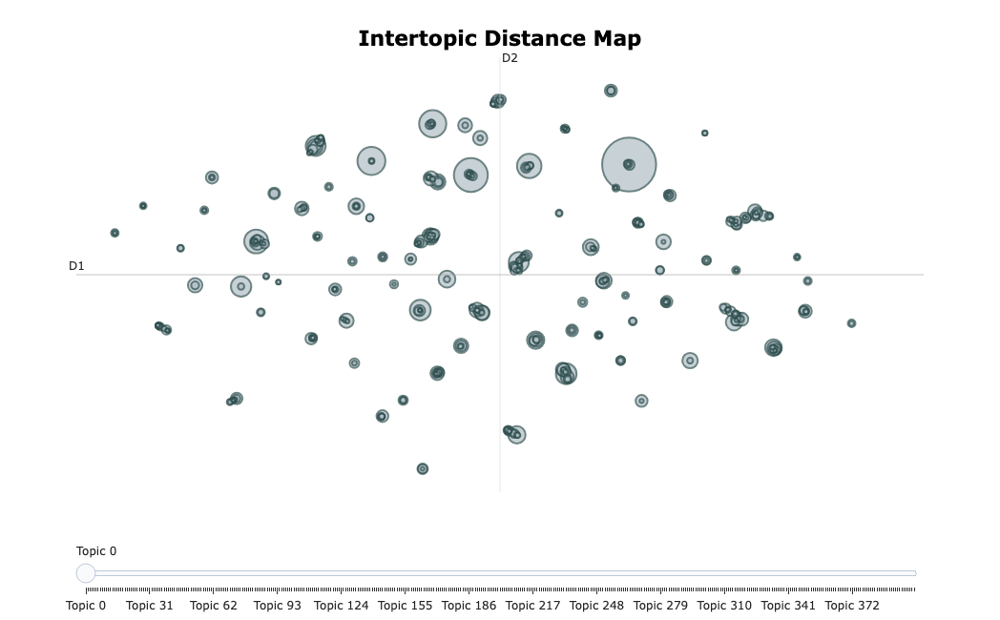

In [17]:
topic_model.visualize_topics()

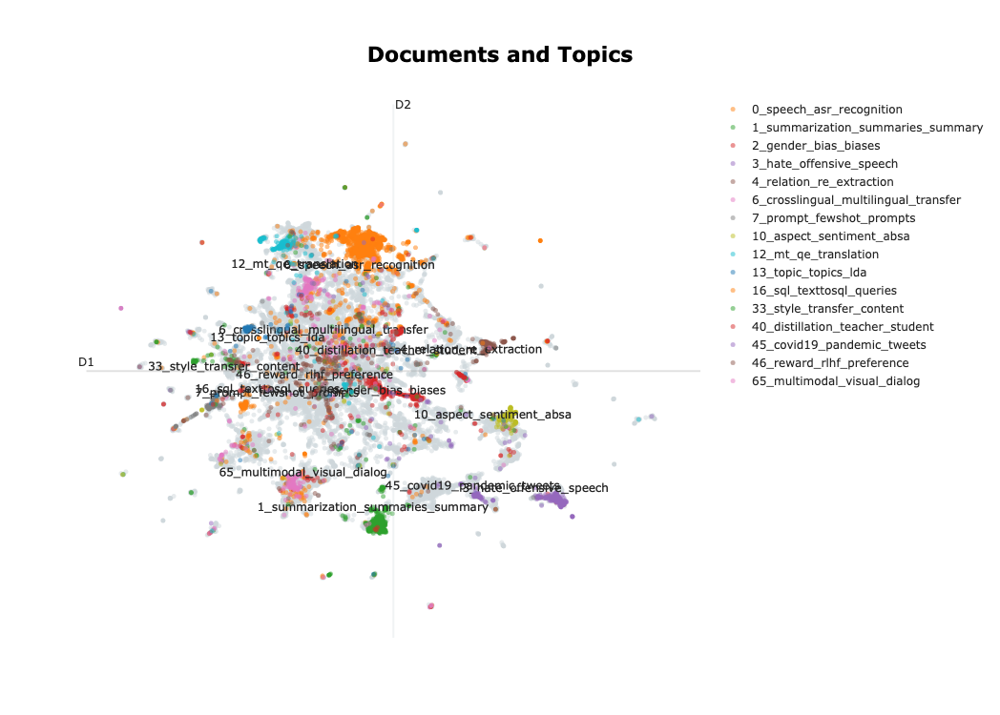

In [18]:
# Visualize a selection of topics and documents
topic_model.visualize_documents(titles, topics=[0, 1, 2, 3, 4, 6, 7, 10, 12, 13, 16, 33, 40, 45, 46, 65])

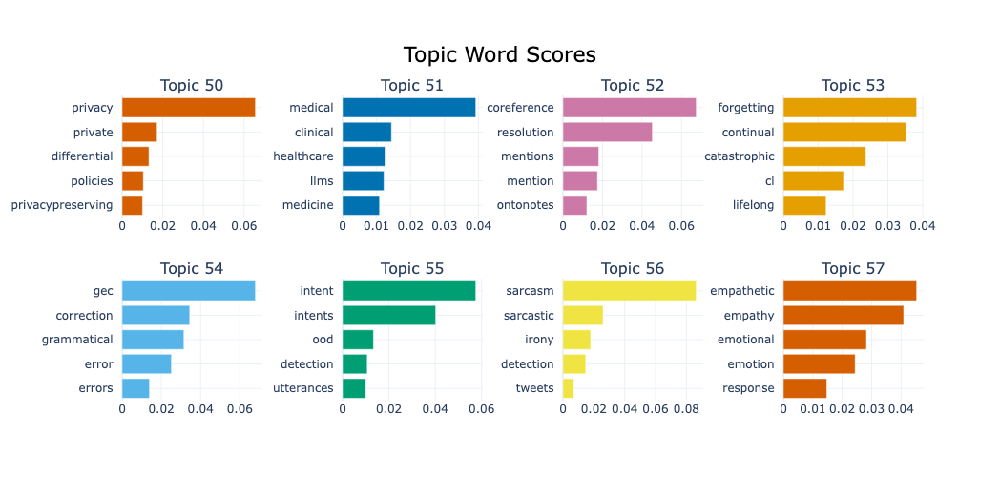

In [19]:
topic_model.visualize_barchart(topics=list(range(50, 58, 1)))

In [26]:
# Save original representations
from copy import deepcopy

original_topics = deepcopy(topic_model.topic_representations_)

In [27]:
def topic_differences(model, original_topics, max_length=75, nr_topics=10):
  """ For the first 10 topics, show the differences in 
  topic representations between two models """
  for topic in range(nr_topics):
 
    # Extract top 5 words per topic per model
    og_words = " | ".join(list(zip(*original_topics[topic]))[0][:5])
    new_words = " | ".join(list(zip(*model.get_topic(topic)))[0][:5])
 
    # Print a 'before' and 'after'
    whitespaces = " " * (max_length - len(og_words))
    print(f"Topic: {topic}    {og_words}{whitespaces}-->     {new_words}")

In [28]:
topic_differences(topic_model, original_topics)

Topic: 0    transcription | transcriptions | voice | corpus | transcripts              -->     transcription | transcriptions | voice | corpus | transcripts
Topic: 1    summarizers | summarizer | summarizing | summarization | summarisation     -->     summarizers | summarizer | summarizing | summarization | summarisation
Topic: 2    bias | biases | gender | gendered | genderneutral                          -->     bias | biases | gender | gendered | genderneutral
Topic: 3    hateful | hate | hatespeech | cyberbullying | speech                       -->     hateful | hate | hatespeech | cyberbullying | speech
Topic: 4    relations | relation | relational | entities | entity                      -->     relations | relation | relational | entities | entity
Topic: 5    entities | entity | annotation | labeling | ner                            -->     entities | entity | annotation | labeling | ner
Topic: 6    multilingual | crosslingual | monolingual | bilingual | languages          -->  

In [31]:
# KeyBERTInspired
from bertopic.representation import KeyBERTInspired

representation_model = KeyBERTInspired()
 
# Update our topic representations
topic_model.update_topics(abstracts, representation_model=representation_model)
 
# Show topic differences
topic_differences(topic_model, original_topics)

Topic: 0    transcription | transcriptions | voice | corpus | transcripts              -->     transcription | transcriptions | voice | corpus | transcripts
Topic: 1    summarizers | summarizer | summarizing | summarization | summarisation     -->     summarizers | summarizer | summarizing | summarization | summarisation
Topic: 2    bias | biases | gender | gendered | genderneutral                          -->     bias | biases | gender | gendered | genderneutral
Topic: 3    hateful | hate | hatespeech | cyberbullying | speech                       -->     hateful | hate | hatespeech | cyberbullying | speech
Topic: 4    relations | relation | relational | entities | entity                      -->     relations | relation | relational | entities | entity
Topic: 5    entities | entity | annotation | labeling | ner                            -->     entities | entity | annotation | labeling | ner
Topic: 6    multilingual | crosslingual | monolingual | bilingual | languages          -->  

In [32]:
# Part-of-Speech tagging
from bertopic.representation import PartOfSpeech

representation_model = PartOfSpeech("en_core_web_sm")
 
# Use the representation model in BERTopic on top of the default pipeline
topic_model.update_topics(abstracts, representation_model=representation_model)
 
# Show topic differences
topic_differences(topic_model, original_topics)

Topic: 0    transcription | transcriptions | voice | corpus | transcripts              -->     speech | recognition | acoustic | audio | spoken
Topic: 1    summarizers | summarizer | summarizing | summarization | summarisation     -->     summarization | summaries | summary | abstractive | extractive
Topic: 2    bias | biases | gender | gendered | genderneutral                          -->     gender | bias | biases | fairness | debiasing
Topic: 3    hateful | hate | hatespeech | cyberbullying | speech                       -->     hate | offensive | speech | detection | abusive
Topic: 4    relations | relation | relational | entities | entity                      -->     relation | extraction | relations | entity | entities
Topic: 5    entities | entity | annotation | labeling | ner                            -->     entity | recognition | entities | nested | span
Topic: 6    multilingual | crosslingual | monolingual | bilingual | languages          -->     crosslingual | multilingual

In [33]:
# Maximal Marginal Relevance
from bertopic.representation import MaximalMarginalRelevance

representation_model = MaximalMarginalRelevance(diversity=0.5)
 
# Use the representation model in BERTopic on top of the default pipeline
topic_model.update_topics(abstracts, representation_model=representation_model)
 
# Show topic differences
topic_differences(topic_model, original_topics)

Topic: 0    transcription | transcriptions | voice | corpus | transcripts              -->     asr | recognition | endtoend | speaker | slu
Topic: 1    summarizers | summarizer | summarizing | summarization | summarisation     -->     extractive | document | factual | evaluation | salient
Topic: 2    bias | biases | gender | gendered | genderneutral                          -->     gender | bias | fairness | stereotypes | mitigation
Topic: 3    hateful | hate | hatespeech | cyberbullying | speech                       -->     speech | abusive | hateful | cyberbullying | classification
Topic: 4    relations | relation | relational | entities | entity                      -->     extraction | relations | entity | documentlevel | docre
Topic: 5    entities | entity | annotation | labeling | ner                            -->     ner | entities | fewshot | datasets | spans
Topic: 6    multilingual | crosslingual | monolingual | bilingual | languages          -->     multilingual | transfer

### Text Generation

In [1]:
from transformers import pipeline
from bertopic.representation import TextGeneration
 
# Text2Text Generation with Flan-T5
generator = pipeline('text2text-generation', model='google/flan-t5-xl')
representation_model = TextGeneration(generator)
 
# Use the representation model in BERTopic on top of the default pipeline
topic_model.update_topics(abstracts, representation_model=representation_model)
 
# Show topic differences
topic_differences(topic_model, original_topics)

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

NameError: name 'topic_model' is not defined

In [ ]:
from bertopic.representation import OpenAI
 
# OpenAI Representation Model
prompt = """
I have a topic that contains the following documents: \n[DOCUMENTS]
The topic is described by the following keywords: [KEYWORDS]
 
Based on the information above, extract a short topic label in the following format:
topic: <topic label>
"""
representation_model = OpenAI(model="gpt-3.5-turbo", delay_in_seconds=10, chat=True)
 
# Use the representation model in BERTopic on top of the default pipeline
topic_model.update_topics(abstracts, representation_model=representation_model)
 
# Show topic differences
topic_differences(topic_model, original_topics)

In [ ]:
import cohere
from bertopic.representation import Cohere
 
# Cohere Representation Model
co = cohere.Client(my_api_key)
representation_model = Cohere(co)
 
# Use the representation model in BERTopic on top of the default pipeline
topic_model.update_topics(abstracts, representation_model=representation_model)
 
# Show topic differences
topic_differences(topic_model, original_topics)

In [ ]:
from langchain.llms import OpenAI
from langchain.chains.question_answering import load_qa_chain
from bertopic.representation import LangChain
 
# Langchain representation model
chain = load_qa_chain(OpenAI(temperature=0, openai_api_key=MY_API_KEY), chain_type="stuff")
representation_model = LangChain(chain)
 
# Use the representation model in BERTopic on top of the default pipeline
topic_model.update_topics(abstracts, representation_model=representation_model)
 
# Show topic differences
topic_differences(topic_model, original_topics)